In [1]:
import warnings
warnings.simplefilter(action='ignore')

In [2]:
import scanpy as sc
import torch
import scarches as sca
import matplotlib.pyplot as plt
import numpy as np

Global seed set to 0


In [3]:
sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(dpi=200)
sc.set_figure_params(figsize=(4, 4))

In [4]:
adata = sc.read('kang_count.h5ad')

In [5]:
adata.obs["study"] = "Kang"

In [6]:
sca.add_annotations(adata, 'c2.cp.reactome.v4.0.symbols.gmt', min_genes=12)

In [7]:
sca.add_annotations(adata, 'c2.cp.reactome.v4.0.symbols.gmt', min_genes=12, clean=False, uns_key="full_terms", varm_key="If")

In [8]:
adata._inplace_subset_var(adata.varm['I'].sum(1)>0)

In [9]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000, flavor='seurat_v3', subset=True)

In [10]:
select_terms = adata.varm['I'].sum(0)>12

In [11]:
adata.uns['terms'] = np.array(adata.uns['terms'])[select_terms].tolist()

In [12]:
adata.uns['full_terms'] = np.array(adata.uns['full_terms'])[select_terms].tolist()

In [13]:
adata.varm['I'] = adata.varm['I'][:, select_terms]

In [14]:
del adata.varm["If"]

In [15]:
adata._inplace_subset_var(adata.varm['I'].sum(1)>0)

In [16]:
adata.uns["full_terms"] = [term.replace("REACTOME_", "") for term in adata.uns["full_terms"]]

## Training

In [17]:
intr_cvae = sca.models.TRVAE(
    adata=adata,
    condition_key='study',
    hidden_layer_sizes=[300, 300, 300],
    use_mmd=False,
    recon_loss='nb',
    mask=adata.varm['I'].T
)


INITIALIZING NEW NETWORK..............
Encoder Architecture:
	Input Layer in, out and cond: 1981 300 1
	Hidden Layer 1 in/out: 300 300
	Hidden Layer 2 in/out: 300 300
	Mean/Var Layer in/out: 300 267
Decoder Architecture:
	Cond layer in, ext, ext_m, cond, out and :  267 0 0 1 1981
	with hard mask.


In [14]:
ALPHA = 0.3
OMEGA = None

early_stopping_kwargs = {
    "early_stopping_metric": "val_unweighted_loss", # val_unweighted_loss
    "threshold": 0,
    "patience": 50,
    "reduce_lr": True,
    "lr_patience": 13,
    "lr_factor": 0.1,
}

In [15]:
N_EPOCHS = 200
EPOCHS_ANNEAL = 100

In [16]:
intr_cvae.train(
    n_epochs=N_EPOCHS, 
    alpha_epoch_anneal=EPOCHS_ANNEAL, 
    alpha=ALPHA, 
    omega=OMEGA,
    alpha_kl=0.25,
    weight_decay=0., 
    early_stopping_kwargs=early_stopping_kwargs,
    use_early_stopping=True,
    seed=2020
)

Init proximal operator for main terms.
 |██████████████------| 71.0%  - epoch_loss:  426.98 - epoch_recon_loss:  399.66 - epoch_kl_loss:  109.31 - val_loss:  420.19 - val_recon_loss:  394.23 - val_kl_loss:  103.83
ADJUSTED LR
 |███████████████████-| 98.5%  - epoch_loss:  422.92 - epoch_recon_loss:  395.75 - epoch_kl_loss:  108.67 - val_loss:  419.39 - val_recon_loss:  393.21 - val_kl_loss:  104.73
ADJUSTED LR
 |████████████████████| 100.0%  - epoch_loss:  421.47 - epoch_recon_loss:  394.33 - epoch_kl_loss:  108.56 - val_loss:  419.42 - val_recon_loss:  393.30 - val_kl_loss:  104.49
Saving best state of network...
Best State was in Epoch 182


In [15]:
inactive_idx = ~(intr_cvae.model.decoder.L0.expr_L.weight.data.norm(p=2, dim=0)>0).cpu().numpy()

In [16]:
print('Inactive terms:')
[term for i, term in enumerate(adata.uns['terms']) if inactive_idx[i]]

Inactive terms:


[]

In [17]:
MEAN = False

In [18]:
adata.obsm['X_cvae'] = intr_cvae.get_latent(mean=MEAN)[:, ~inactive_idx]

In [19]:
sc.pp.neighbors(adata, use_rep='X_cvae')

In [20]:
sc.tl.umap(adata)

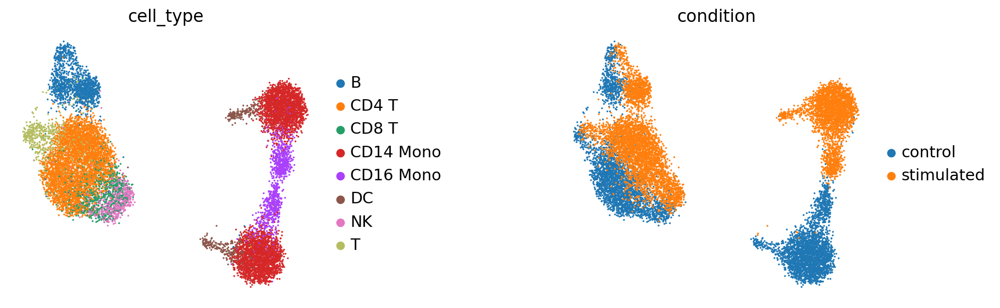

In [21]:
sc.pl.umap(adata, color=['cell_type', 'condition'], frameon=False, wspace=0.6)

In [41]:
adata.obs["cell_type_joint"] = adata.obs.cell_type.tolist()

In [42]:
celltypes_replace = {}
celltypes_replace['CD20+ B cells'] = 'B'
celltypes_replace['CD4 T'] = 'CD4+ T cells'
celltypes_replace['CD8 T'] = 'CD8+ T cells'
celltypes_replace['CD14 Mono'] = 'CD14+ Monocytes'
celltypes_replace['CD16 Mono'] = 'CD16+ Monocytes'
celltypes_replace['NK'] = 'NK cells'

for cat in adata.obs["cell_type_joint"].unique():
    if cat in celltypes_replace:
        adata.obs['cell_type_joint'][adata.obs['cell_type_joint']==cat] = celltypes_replace[cat]

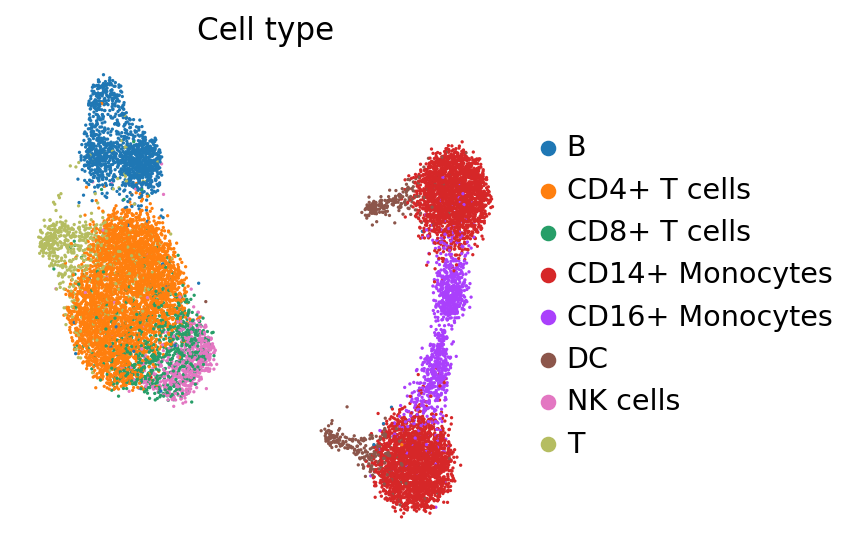

In [43]:
sc.pl.umap(adata, color='cell_type_joint', frameon=False, title="Cell type")

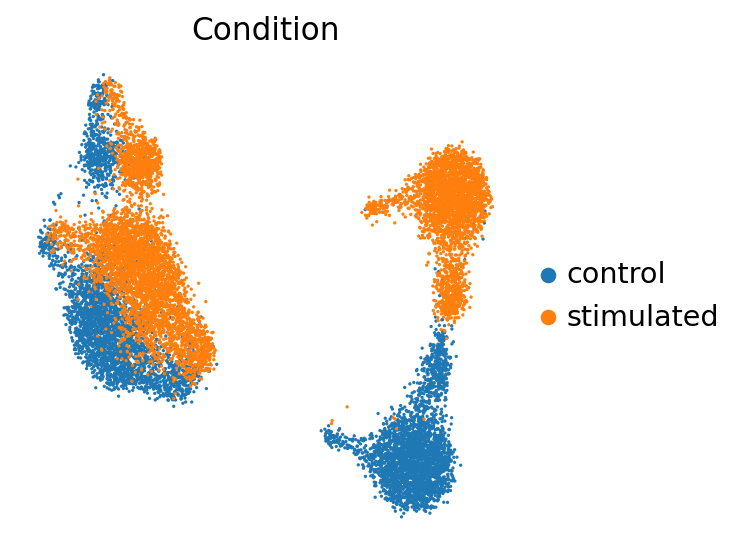

In [44]:
sc.pl.umap(adata, color='condition', frameon=False, title="Condition")

In [22]:
scores_cond = intr_cvae.latent_enrich('condition', comparison="control", adata=adata, n_perm=12000, exact=True)

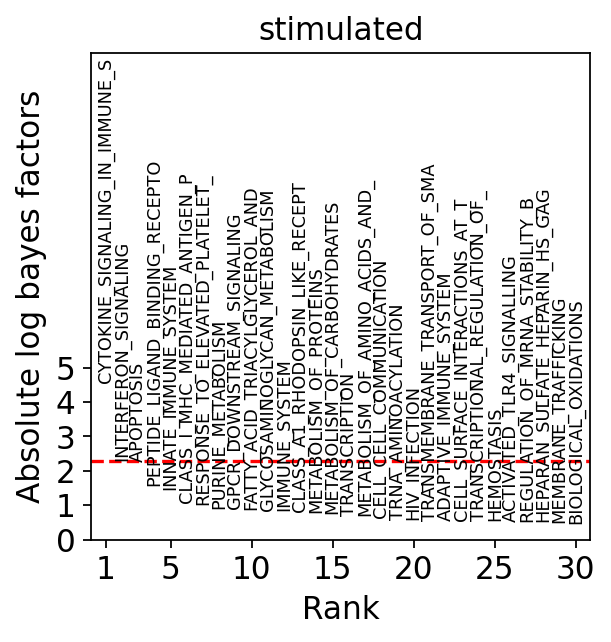

In [32]:
fig = sca.plotting.plot_abs_bfs(scores_cond, np.array(adata.uns["terms"]), keys='stimulated', yt_step=1, fontsize=8, scale_y=3.1)

In [24]:
adata_control = adata[adata.obs["condition"] == "control"]

In [25]:
scores_ct = intr_cvae.latent_enrich('cell_type', adata=adata_control, n_perm=12000, exact=True)

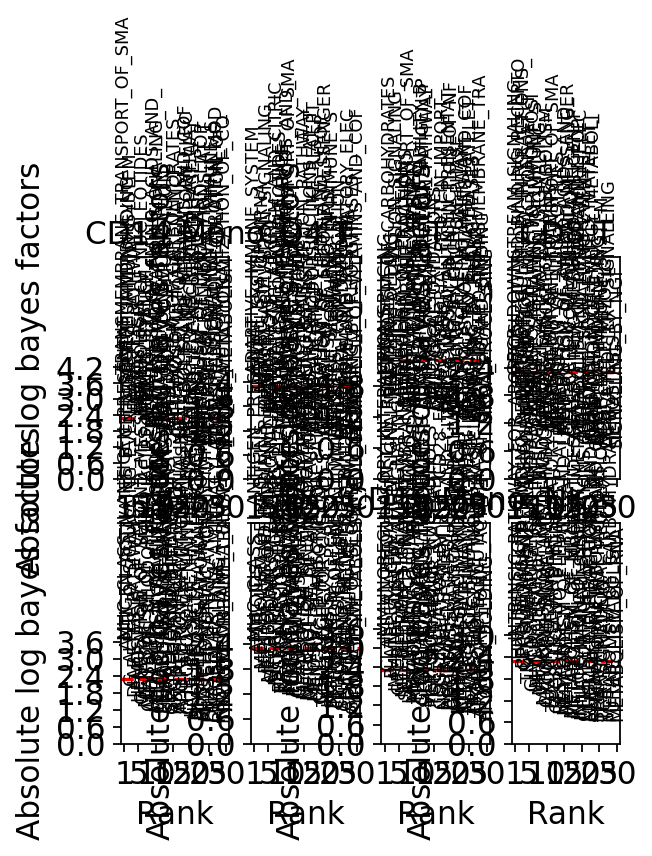

In [33]:
fig = sca.plotting.plot_abs_bfs(scores_ct, np.array(adata.uns["terms"]), n_cols=4, scale_y=2.1, yt_step=0.6)

In [34]:
fig.set_size_inches(24, 12)

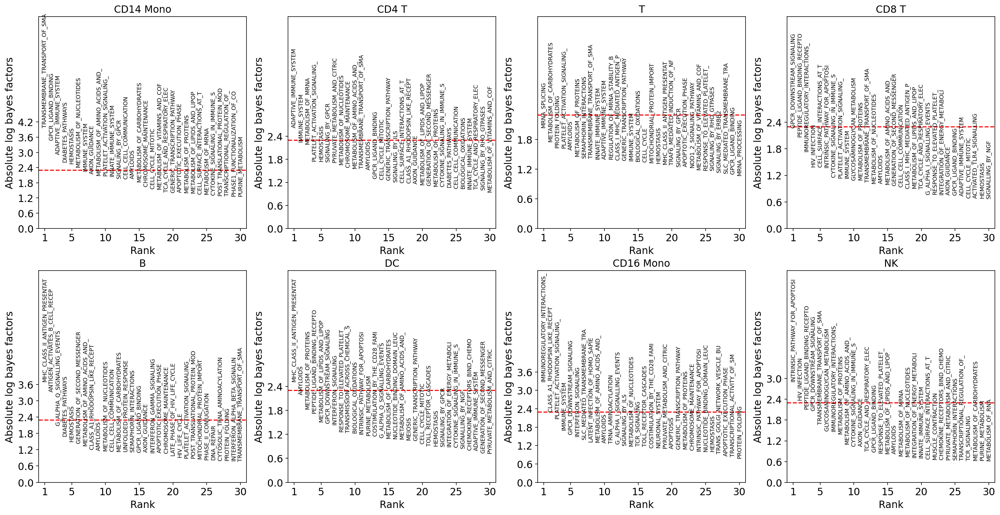

In [35]:
fig

In [29]:
adata_mono = adata[adata.obs["cell_type"] == "CD14 Mono"]

In [30]:
scores_mono_cond = intr_cvae.latent_enrich('condition', comparison="control", adata=adata_mono, n_perm=12000, exact=True)

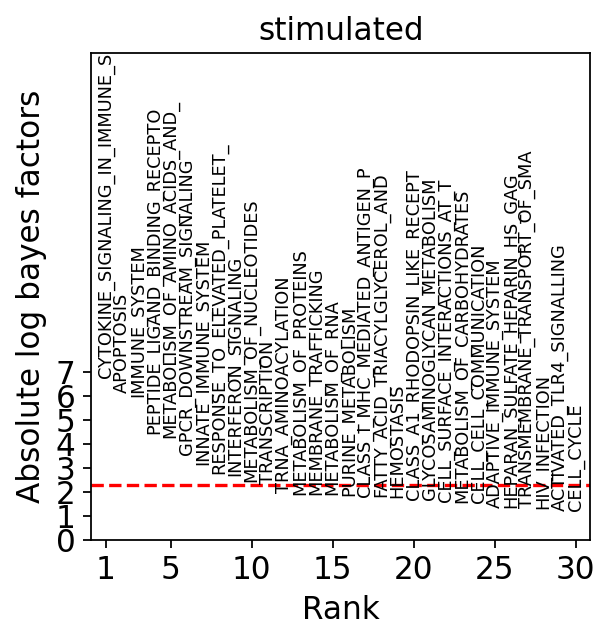

In [39]:
fig = sca.plotting.plot_abs_bfs(scores_mono_cond, np.array(adata.uns["terms"]), keys='stimulated', yt_step=1, fontsize=8, scale_y=3)

In [39]:
#intr_cvae.save("kang_cyto_ifn_b", overwrite=True)

In [14]:
adata.uns["terms"].index("INTERFERON_SIGNALING")

204

In [15]:
adata.uns["terms"].index("CYTOKINE_SIGNALING_IN_IMMUNE_S")

247

In [16]:
len(adata.var_names[adata.varm["I"][:, 204].astype(bool)])

86

In [17]:
len(adata.var_names[adata.varm["I"][:, 247].astype(bool)])

142

In [19]:
len(set(adata.var_names[adata.varm["I"][:, 204].astype(bool)]).intersection(adata.var_names[adata.varm["I"][:, 247].astype(bool)]))

86

In [ ]:
adata.uns["terms"].index("CYTOKINE_SIGNALING_IN_IMMUNE_S")

In [21]:
adata.uns["terms"].index("ANTIGEN_ACTIVATES_B_CELL_RECEP")

37

In [22]:
adata.uns["terms"].index("SIGNALING_BY_THE_B_CELL_RECEPT")

39

In [23]:
len(set(adata.var_names[adata.varm["I"][:, 37].astype(bool)]).intersection(adata.var_names[adata.varm["I"][:, 39].astype(bool)]))

20

## Analysis

In [17]:
intr_cvae = sca.models.TRVAE.load("kang_cyto_ifn_b", adata)


INITIALIZING NEW NETWORK..............
Encoder Architecture:
	Input Layer in, out and cond: 1981 300 1
	Hidden Layer 1 in/out: 300 300
	Hidden Layer 2 in/out: 300 300
	Mean/Var Layer in/out: 300 267
Decoder Architecture:
	Cond layer in, ext, ext_m, cond, out and :  267 0 0 1 1981
	with hard mask.


In [18]:
MEAN = False

In [19]:
adata.obsm['X_cvae'] = intr_cvae.get_latent(mean=MEAN)

In [20]:
sc.pp.neighbors(adata, use_rep='X_cvae')

In [21]:
sc.tl.umap(adata)

In [20]:
adata.obs["cell_type_joint"] = adata.obs.cell_type.tolist()

In [21]:
celltypes_replace = {}
celltypes_replace['CD20+ B cells'] = 'B'
celltypes_replace['CD4 T'] = 'CD4+ T cells'
celltypes_replace['CD8 T'] = 'CD8+ T cells'
celltypes_replace['CD14 Mono'] = 'CD14+ Monocytes'
celltypes_replace['CD16 Mono'] = 'CD16+ Monocytes'
celltypes_replace['NK'] = 'NK cells'

for cat in adata.obs["cell_type_joint"].unique():
    if cat in celltypes_replace:
        adata.obs['cell_type_joint'][adata.obs['cell_type_joint']==cat] = celltypes_replace[cat]

In [22]:
sc.set_figure_params(figsize=(4, 4))
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sb

font = {'family' : 'Arial',
        'size'   : 14}

matplotlib.rc('font', **font)
matplotlib.rc('ytick', labelsize=14)
matplotlib.rc('xtick', labelsize=14)
matplotlib.rcParams["figure.dpi"] = 200
plt.rcParams["axes.grid"] = False

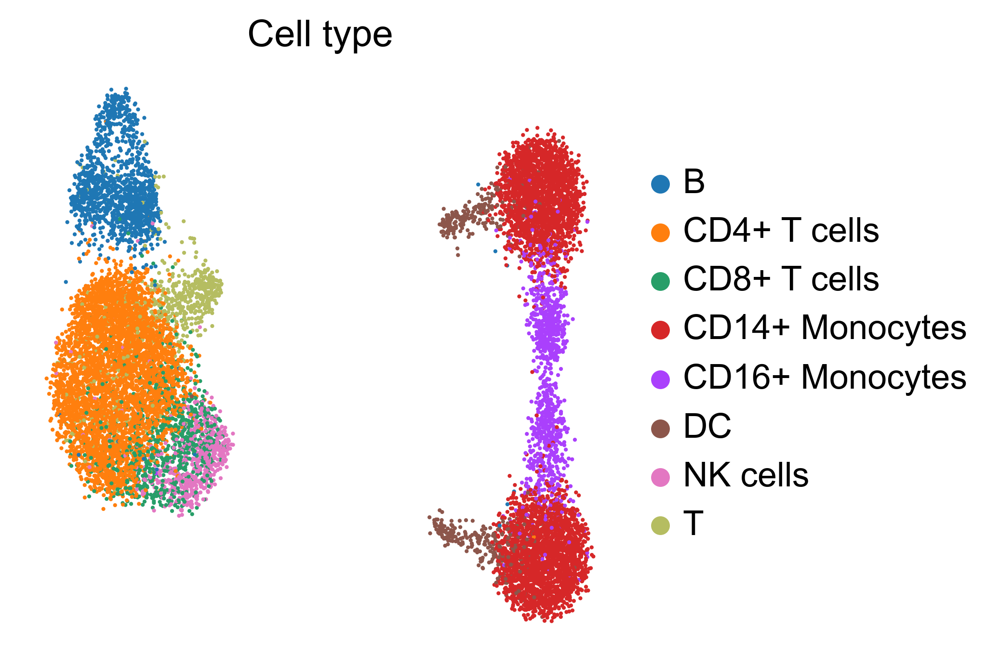

In [25]:
sc.pl.umap(adata, color='cell_type_joint', frameon=False, title="Cell type")

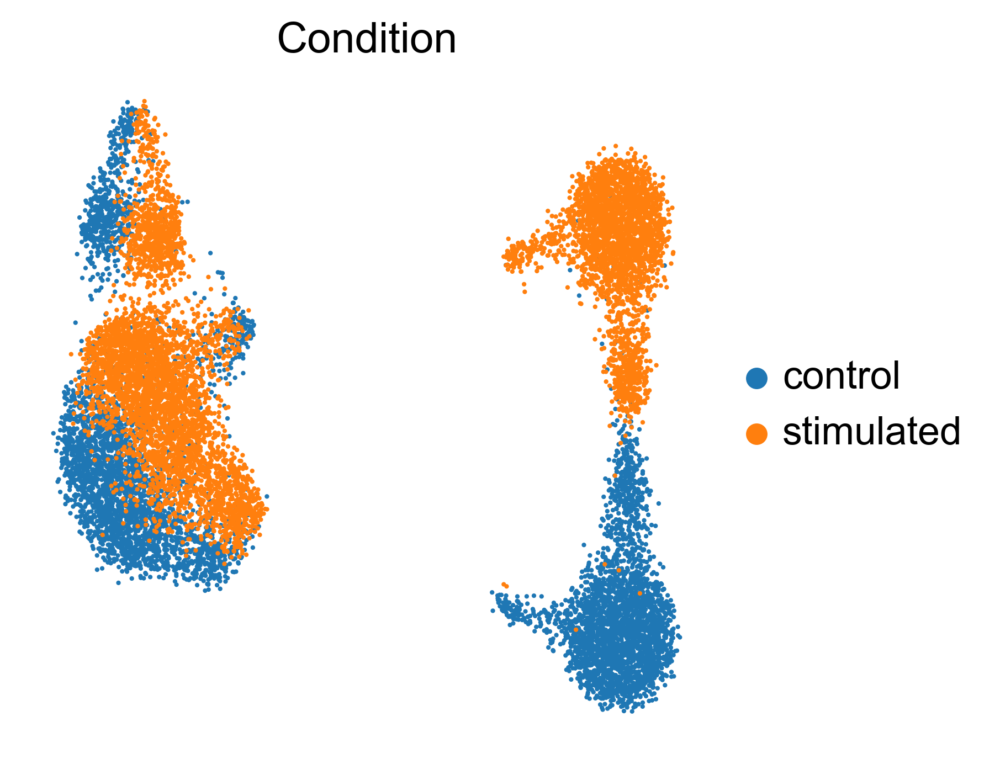

In [26]:
sc.pl.umap(adata, color='condition', frameon=False, title="Condition")

In [23]:
scores_cond = intr_cvae.latent_enrich('condition', comparison="control", adata=adata, n_perm=12000, exact=True)

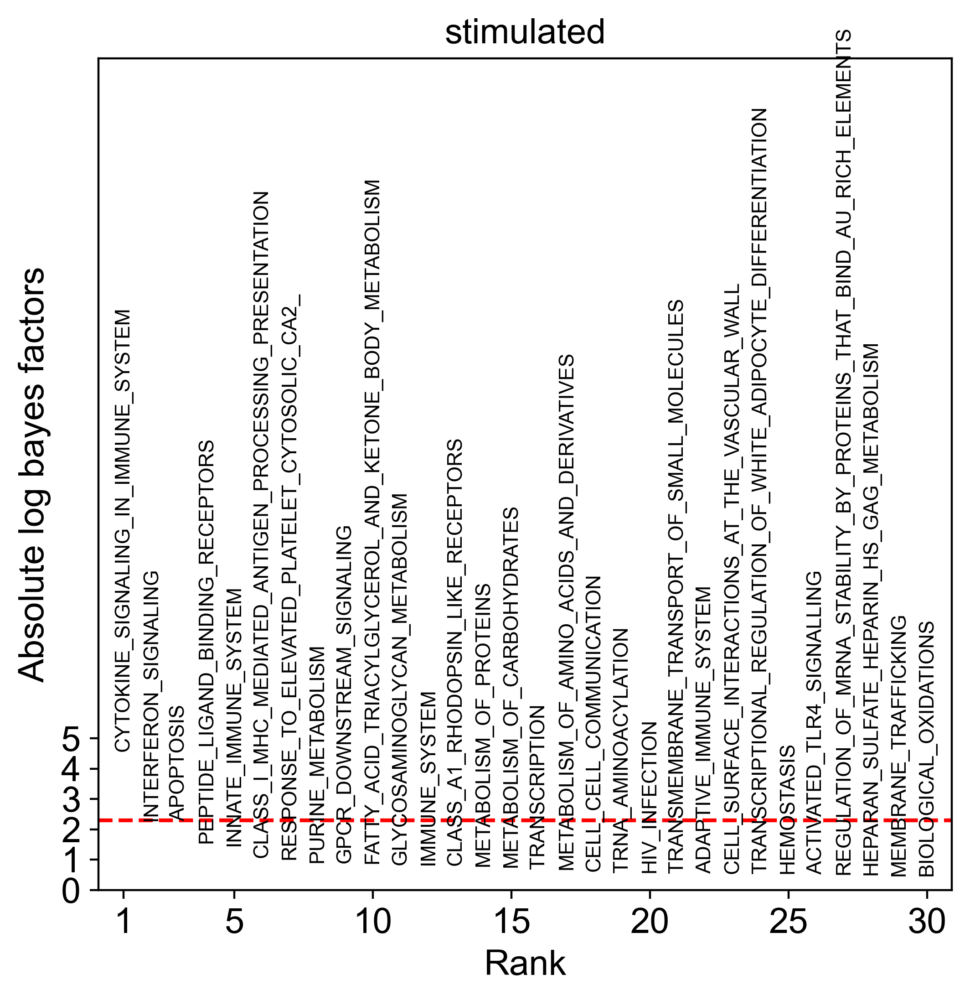

In [26]:
fig = sca.plotting.plot_abs_bfs(scores_cond, np.array(adata.uns["full_terms"]), keys='stimulated', yt_step=1, fontsize=8, scale_y=6)

In [29]:
adata.obsm["X_cvae"] *= intr_cvae._latent_directions()

In [30]:
adata.obs["INTERFERON_SIGNALING"] = adata.obsm["X_cvae"][:, adata.uns["terms"].index("INTERFERON_SIGNALING")]

In [31]:
adata.obs["CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM"] = adata.obsm["X_cvae"][:, adata.uns["terms"].index("CYTOKINE_SIGNALING_IN_IMMUNE_S")]

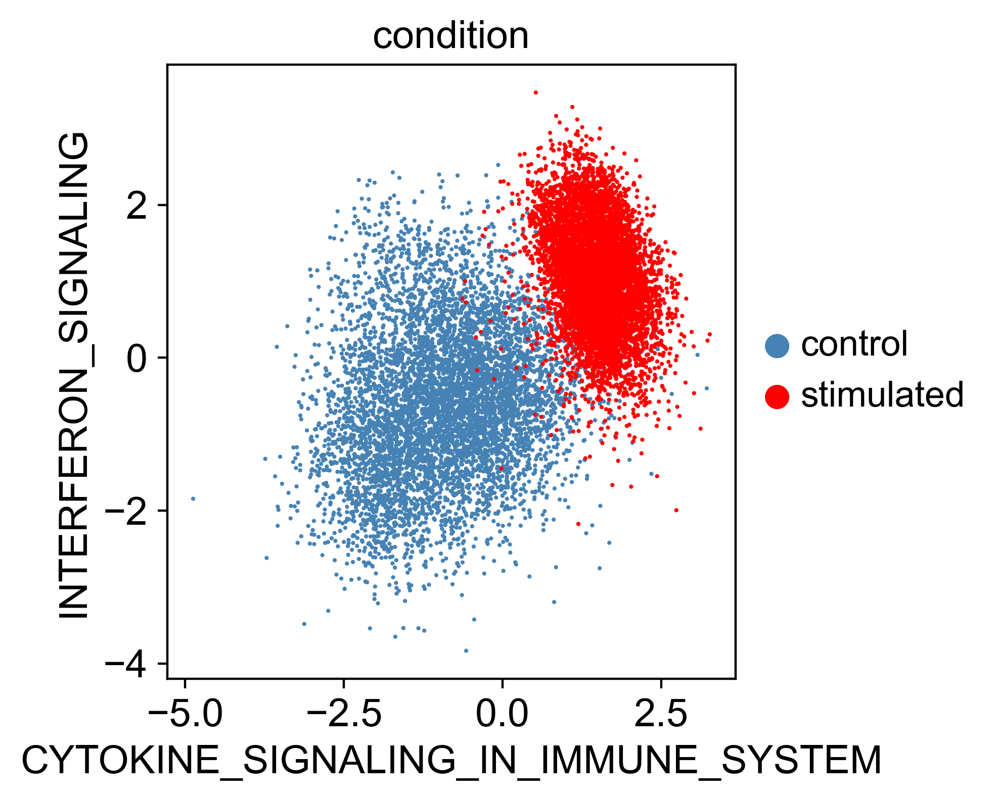

In [32]:
sc.pl.scatter(adata, x="CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM", y="INTERFERON_SIGNALING", color="condition", palette=['steelblue', 'red'])

In [33]:
adata.obs["MHC_CLASS_II_ANTIGEN_PRESENTATION"] = adata.obsm["X_cvae"][:, adata.uns["terms"].index("MHC_CLASS_II_ANTIGEN_PRESENTAT")]

In [34]:
adata.obs["ANTIGEN_ACTIVATES_B_CELL_RECEPTOR"] = adata.obsm["X_cvae"][:, adata.uns["terms"].index("ANTIGEN_ACTIVATES_B_CELL_RECEP")]

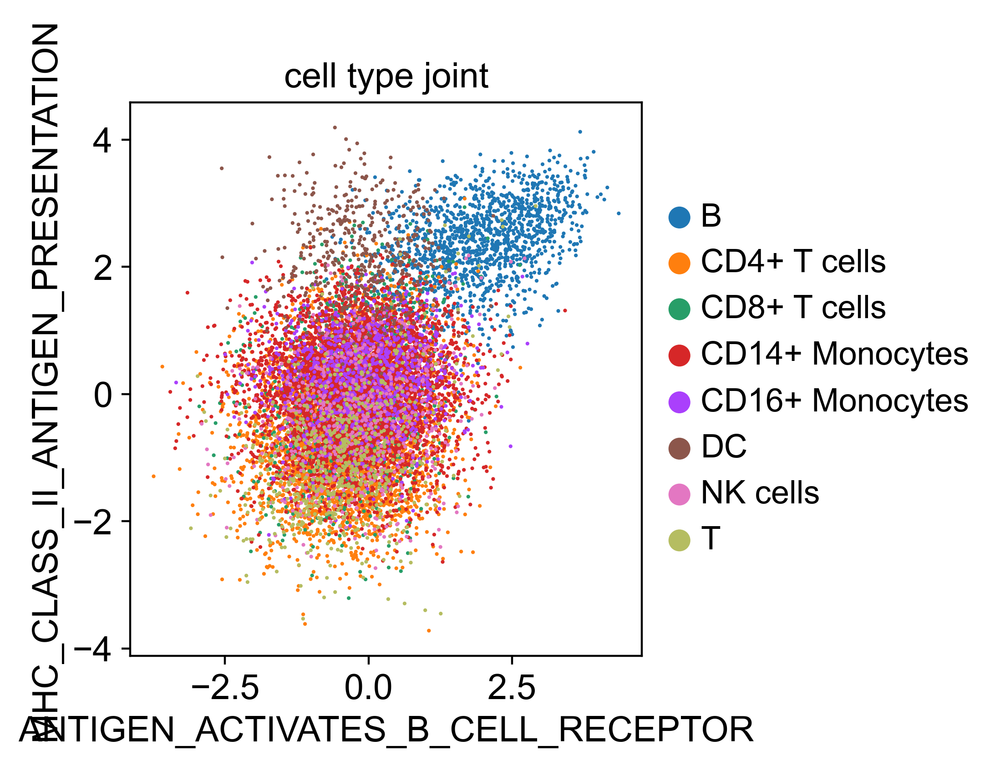

In [35]:
sc.pl.scatter(adata, x="ANTIGEN_ACTIVATES_B_CELL_RECEPTOR", y="MHC_CLASS_II_ANTIGEN_PRESENTATION", 
              color="cell_type_joint")

In [36]:
adata.obs["cells_b"] = "others"

In [37]:
adata.obs["cells_b"][adata.obs.cell_type_joint=="B"] = "B"

In [38]:
adata.strings_to_categoricals()

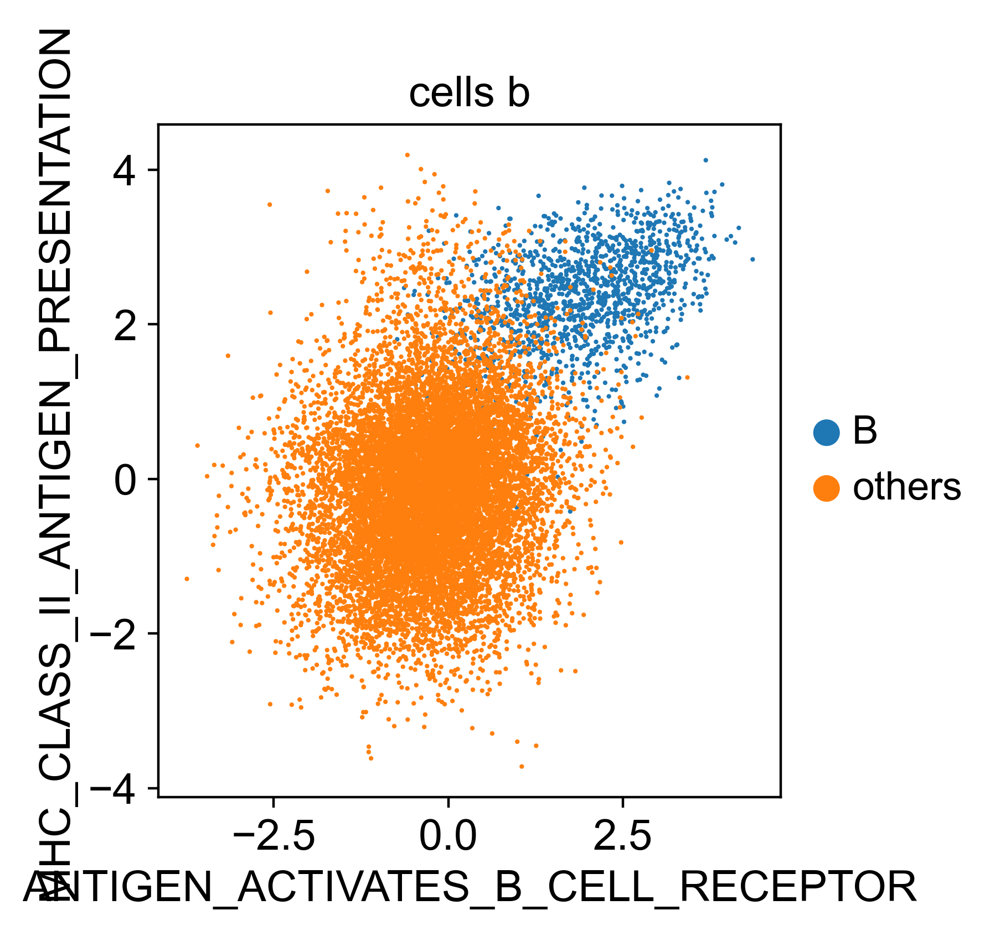

In [39]:
sc.pl.scatter(adata, x="ANTIGEN_ACTIVATES_B_CELL_RECEPTOR", y="MHC_CLASS_II_ANTIGEN_PRESENTATION", 
              color="cells_b")

In [40]:
for i, cat in enumerate(adata.obs['cells_b'].cat.categories):
    if cat=='others':
        adata.uns['cells_b_colors'][i] = 'gray'
    else:
        idx = adata.obs['cell_type_joint'].cat.categories == cat
        adata.uns['cells_b_colors'][i] = np.array(adata.uns['cell_type_joint_colors'])[idx][0]

In [25]:
sc.set_figure_params(figsize=(6, 6))
plt.rcParams["axes.grid"] = False
matplotlib.rcParams["figure.dpi"] = 200

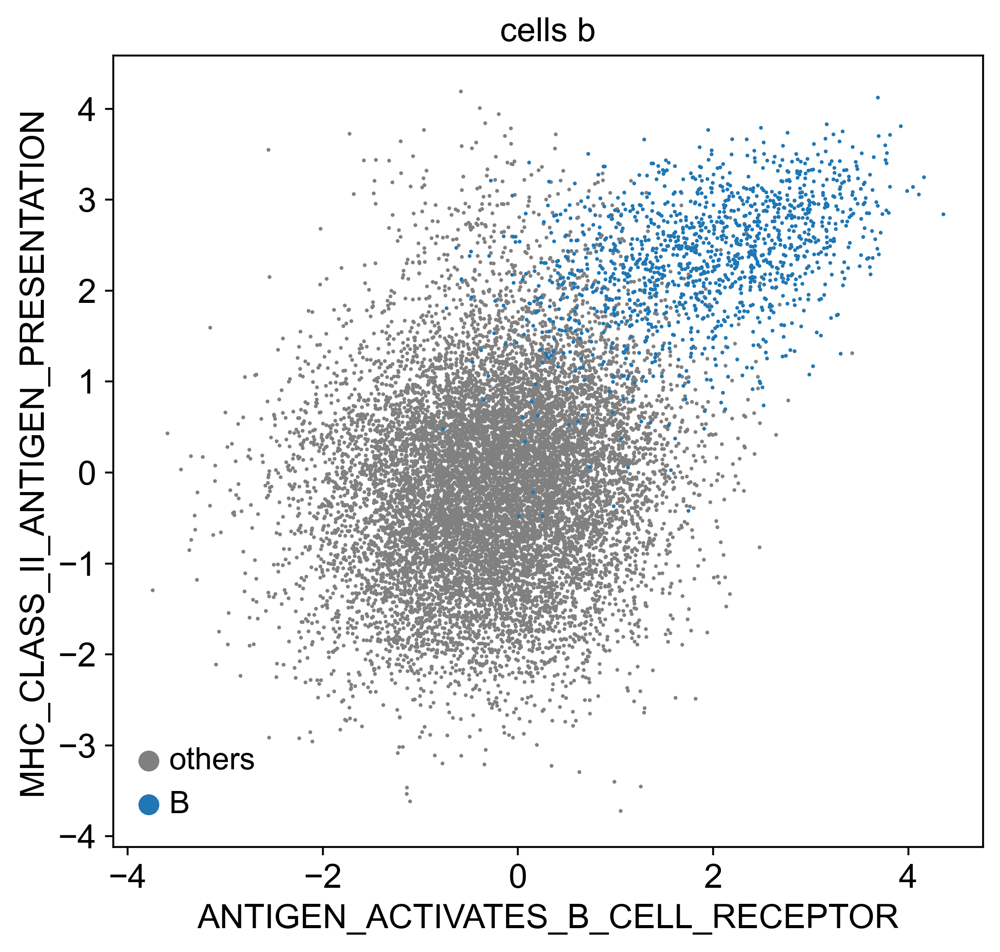

In [42]:
sc.pl.scatter(adata, x="ANTIGEN_ACTIVATES_B_CELL_RECEPTOR", y="MHC_CLASS_II_ANTIGEN_PRESENTATION", 
              color="cells_b", groups=["others", "B"], size=10, legend_loc='lower left')

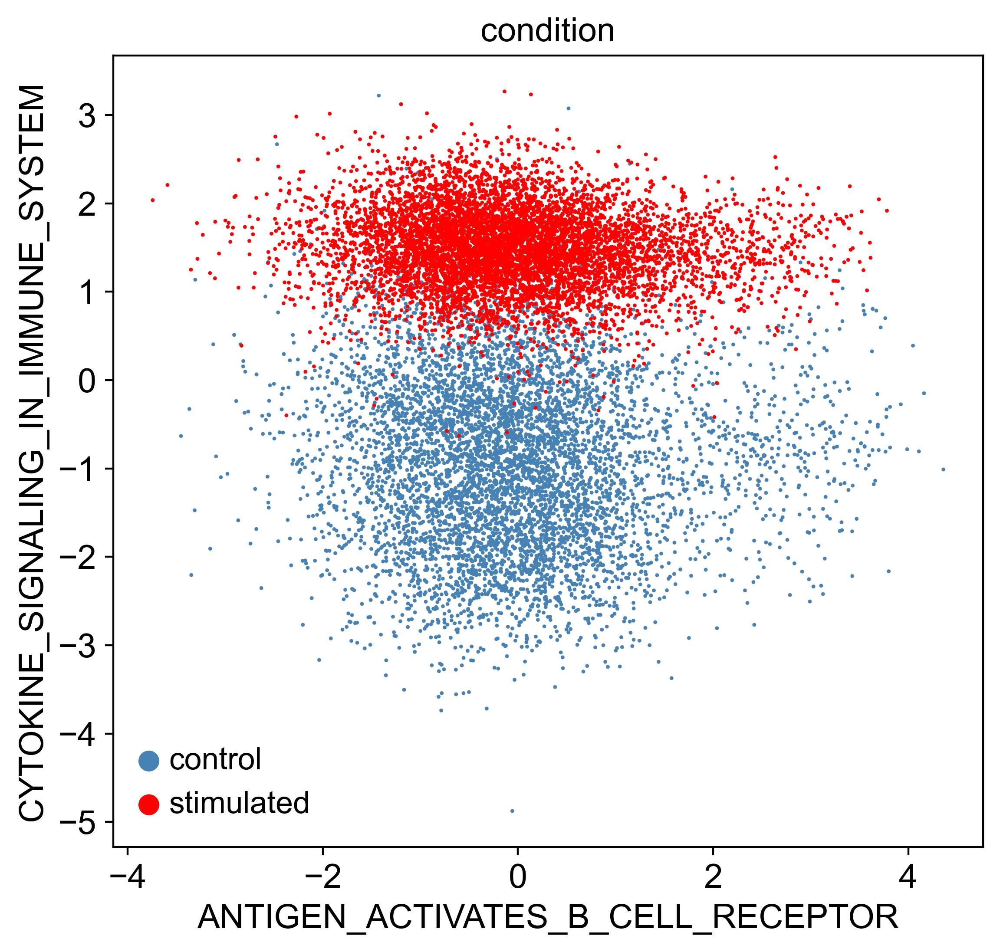

In [43]:
sc.pl.scatter(adata, x="ANTIGEN_ACTIVATES_B_CELL_RECEPTOR", y="CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM", 
              color="condition", palette=['steelblue', 'red'], size=10, legend_loc='lower left')

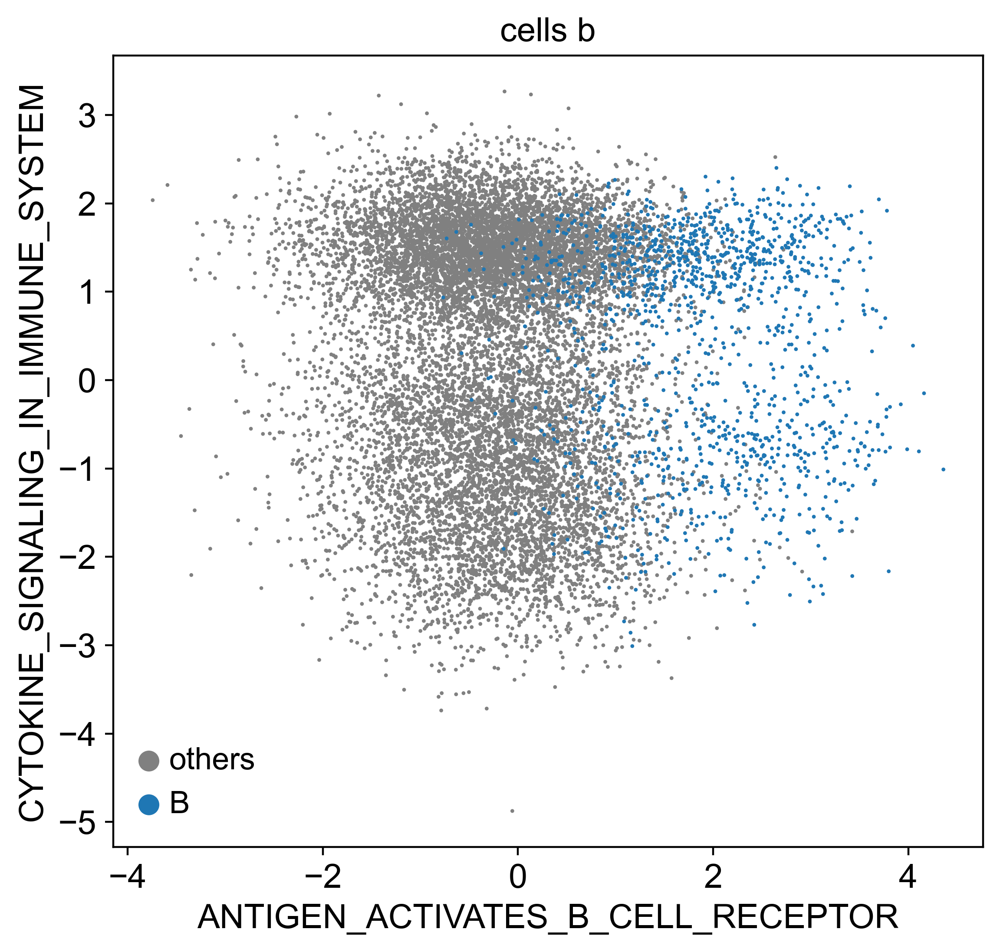

In [44]:
sc.pl.scatter(adata, x="ANTIGEN_ACTIVATES_B_CELL_RECEPTOR", y="CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM", 
              color="cells_b", groups=["others", "B"], size=10, legend_loc='lower left')

In [45]:
adata_control = adata[adata.obs["condition"] == "control"]

In [46]:
scores_ct = intr_cvae.latent_enrich('cell_type_joint', adata=adata_control, n_perm=12000, exact=True)

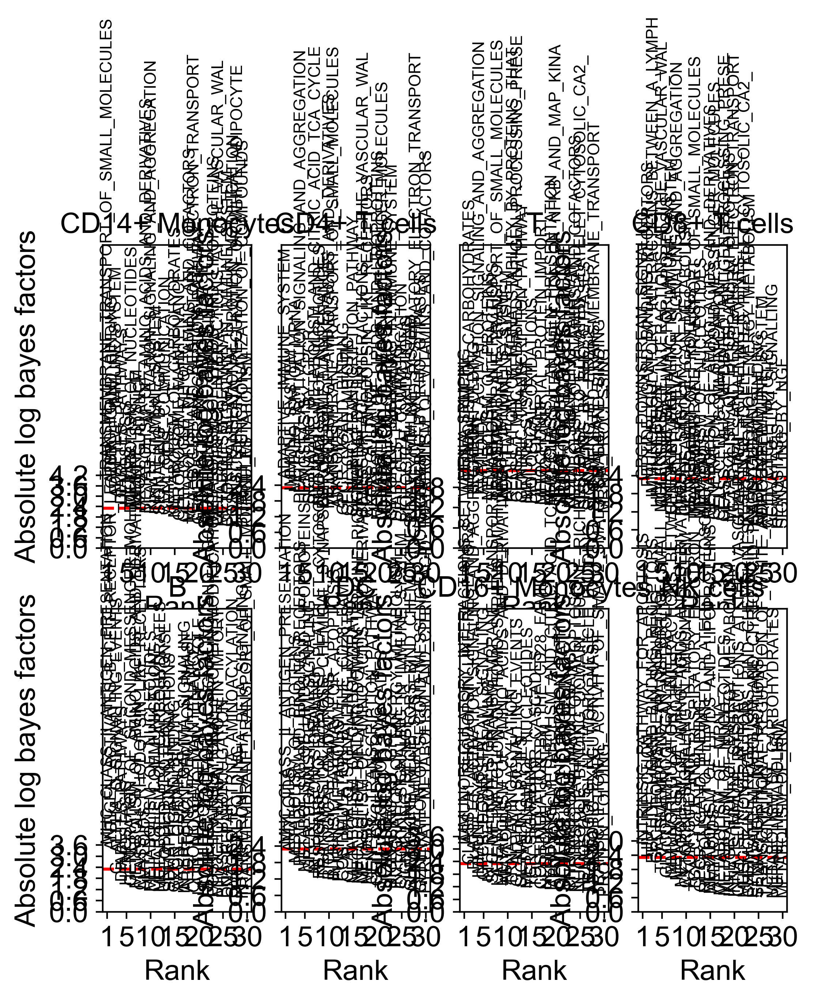

In [79]:
fig = sca.plotting.plot_abs_bfs(scores_ct, np.array([term[:45] for term in adata.uns['full_terms']]), n_cols=4, scale_y=4.4, yt_step=0.6)

In [82]:
fig.set_size_inches(20, 12)

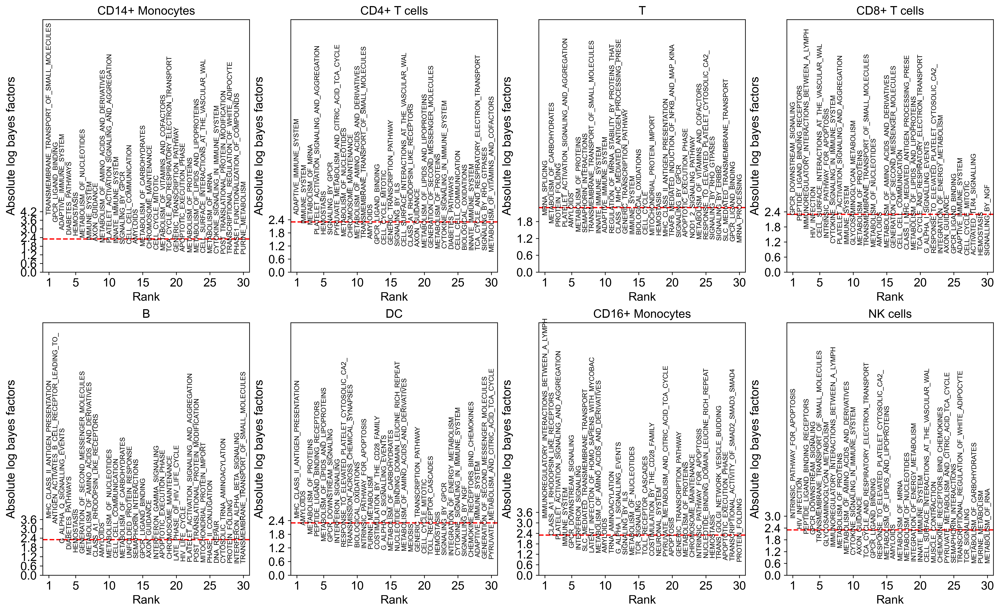

In [83]:
fig

In [35]:
adata.obs["cells_mono"] = "others"

In [36]:
adata.obs["cells_mono"][adata.obs.cell_type_joint=="CD16+ Monocytes"] = "CD16+ Monocytes"

In [37]:
adata.obs["cells_mono"][adata.obs.cell_type_joint=="CD14+ Monocytes"] = "CD14+ Monocytes"

In [38]:
adata.strings_to_categoricals()

In [39]:
adata.obs["cells_mono_merge"] = "others"

In [40]:
adata.obs["cells_mono_merge"][adata.obs.cells_mono!="others"] = "Monocytes"

In [41]:
adata.strings_to_categoricals()

In [44]:
scores_mono = intr_cvae.latent_enrich('cells_mono_merge', comparison="others", adata=adata[adata.obs.condition=="control"], 
                                      n_perm=8000, exact=True)

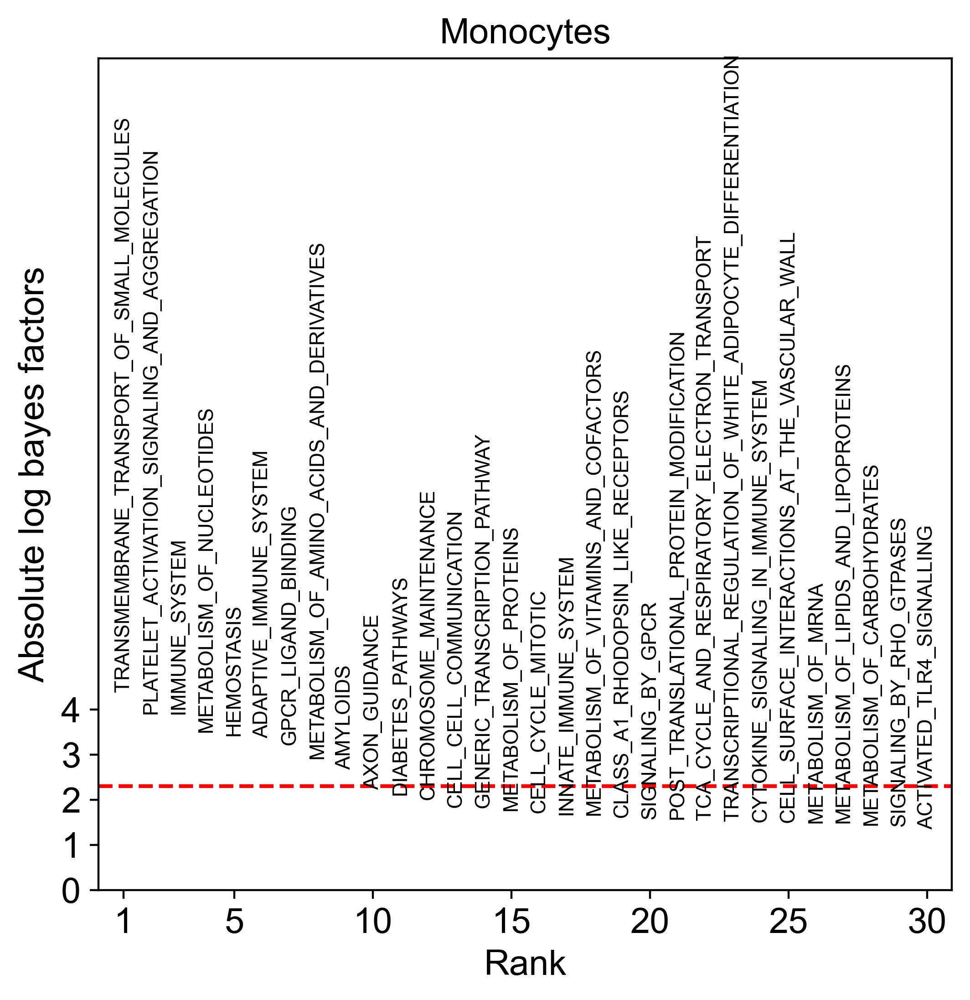

In [45]:
fig = sca.plotting.plot_abs_bfs(scores_mono, np.array(adata.uns["full_terms"]), keys='Monocytes', yt_step=1, fontsize=8, scale_y=4.2)

In [59]:
adata.obs["TRANSMEMBRANE_TRANSPORT_OF_SMALL_MOLECULES"] = adata.obsm["X_cvae"][:, adata.uns["terms"].index("TRANSMEMBRANE_TRANSPORT_OF_SMA")]

In [74]:
adata.obs["IMMUNOREGULATORY_INTERACTIONS_LYMPHOID_AND_NON_LYMPHOID_CELL"] = adata.obsm["X_cvae"][:, adata.uns["terms"].index("IMMUNOREGULATORY_INTERACTIONS_")]

In [ ]:
adata.obs["PLATELET_ACTIVATION_SIGNALING_AND_AGGREGATION"] = adata.obsm["X_cvae"][:, adata.uns["terms"].index("PLATELET_ACTIVATION_SIGNALING_")]

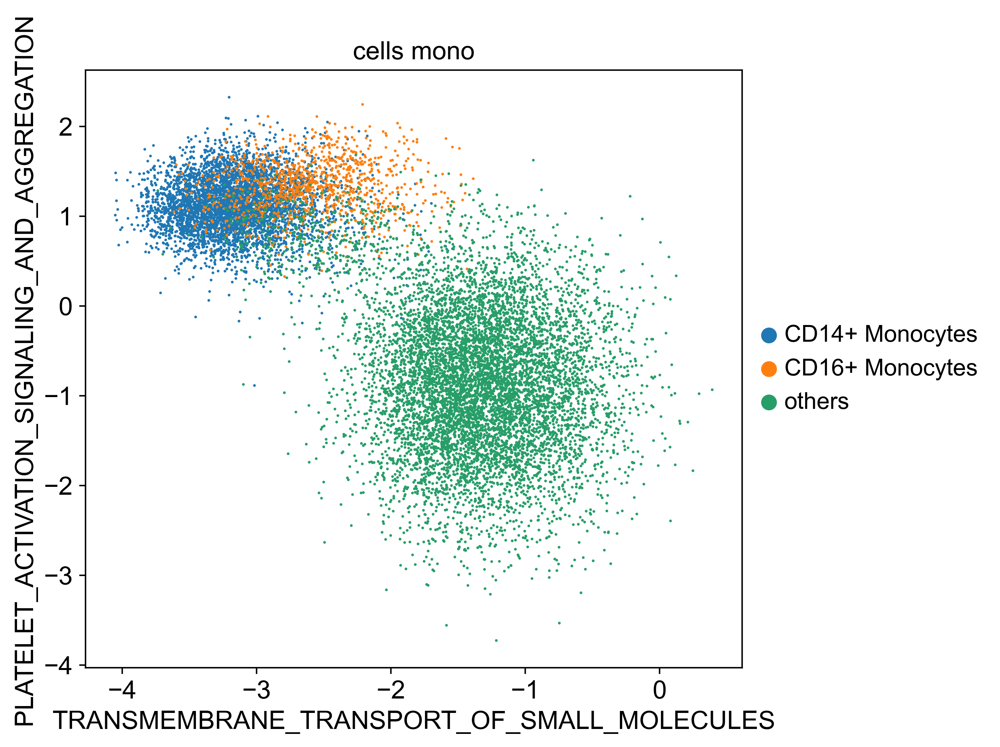

In [61]:
sc.pl.scatter(adata, x="TRANSMEMBRANE_TRANSPORT_OF_SMALL_MOLECULES", y="PLATELET_ACTIVATION_SIGNALING_AND_AGGREGATION", 
              color="cells_mono")

In [62]:
for i, cat in enumerate(adata.obs['cells_mono'].cat.categories):
    if cat=='others':
        adata.uns['cells_mono_colors'][i] = 'gray'
    else:
        idx = adata.obs['cell_type_joint'].cat.categories == cat
        adata.uns['cells_mono_colors'][i] = np.array(adata.uns['cell_type_joint_colors'])[idx][0]

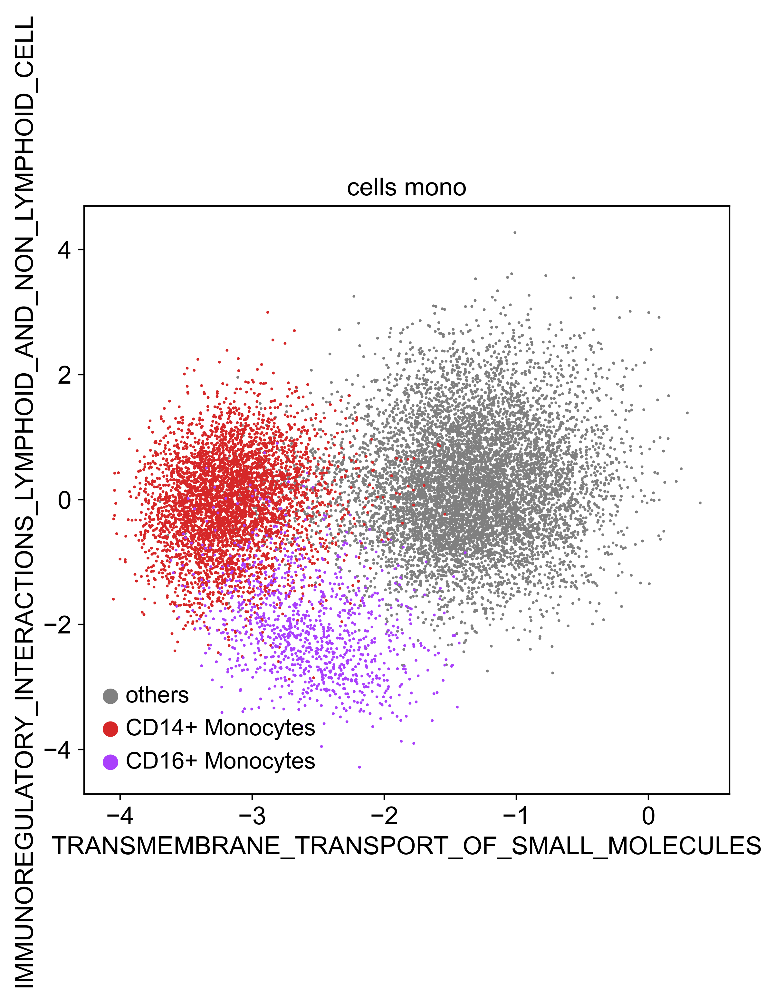

In [75]:
sc.pl.scatter(adata, x="TRANSMEMBRANE_TRANSPORT_OF_SMALL_MOLECULES", y="IMMUNOREGULATORY_INTERACTIONS_LYMPHOID_AND_NON_LYMPHOID_CELL", 
              color="cells_mono", groups=["others", "CD14+ Monocytes", "CD16+ Monocytes"], size=10, legend_loc='lower left')

In [ ]:
sc.pl.scatter(adata, x="TRANSMEMBRANE_TRANSPORT_OF_SMALL_MOLECULES", y="PLATELET_ACTIVATION_SIGNALING_AND_AGGREGATION", 
              color="cells_mono", groups=["others", "CD14+ Monocytes", "CD16+ Monocytes"], size=10, legend_loc='lower left')

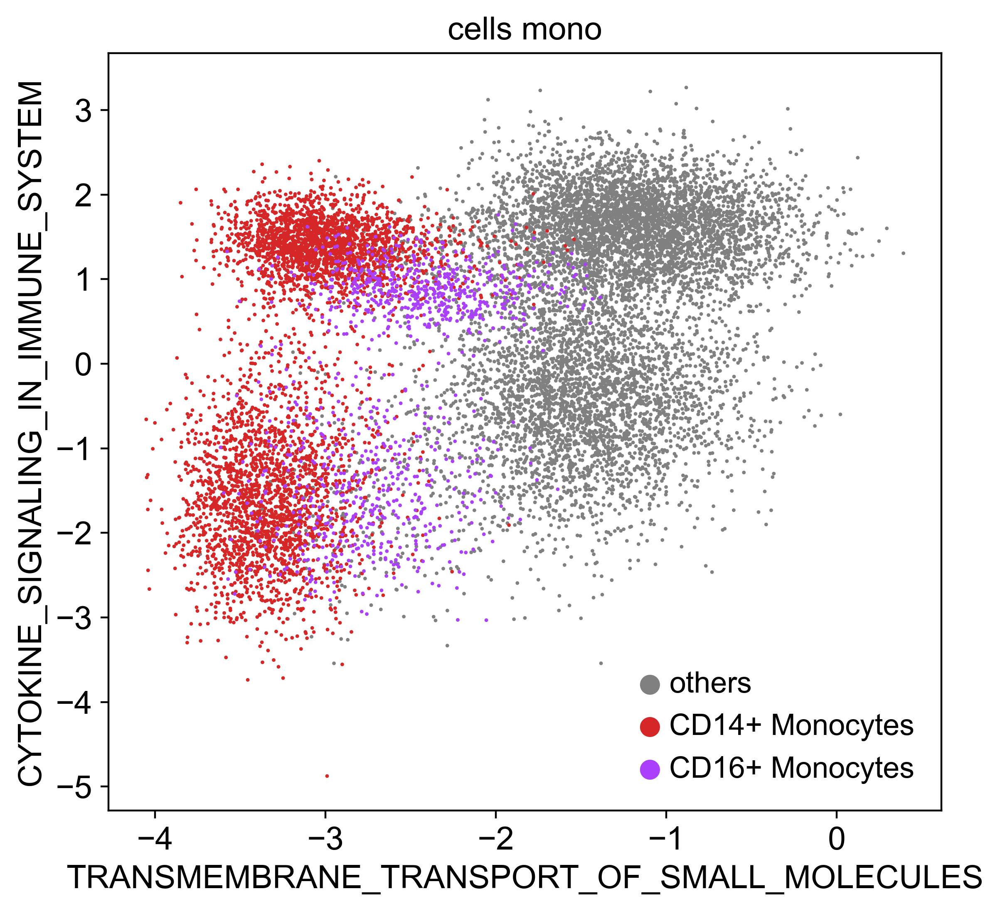

In [64]:
sc.pl.scatter(adata, x="TRANSMEMBRANE_TRANSPORT_OF_SMALL_MOLECULES", y="CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM", 
              color="cells_mono", groups=["others", "CD14+ Monocytes", "CD16+ Monocytes"], size=10, legend_loc='lower right')

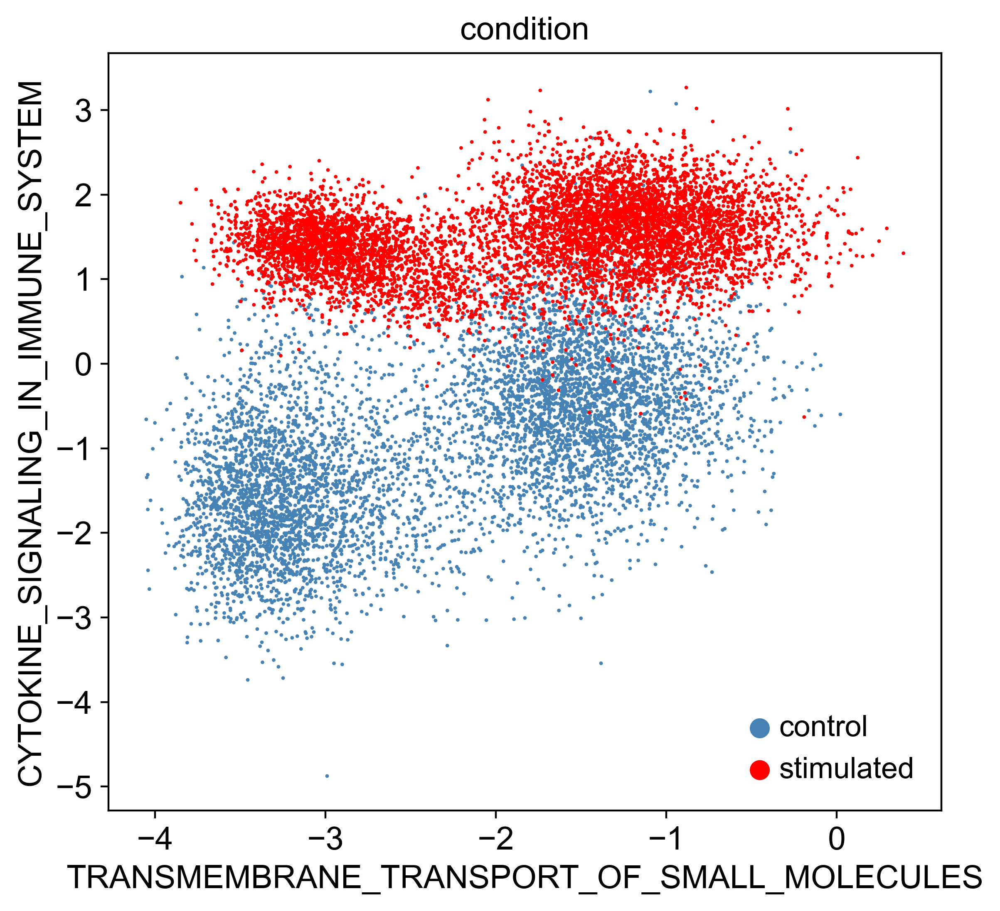

In [65]:
sc.pl.scatter(adata, x="TRANSMEMBRANE_TRANSPORT_OF_SMALL_MOLECULES", y="CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM", 
              color="condition", palette=['steelblue', 'red'], size=10, legend_loc='lower right')

In [27]:
adata_mono = adata[adata.obs["cell_type"] == "CD14 Mono"]

In [28]:
scores_mono_cond = intr_cvae.latent_enrich('condition', comparison="control", adata=adata_mono, n_perm=12000, exact=True)

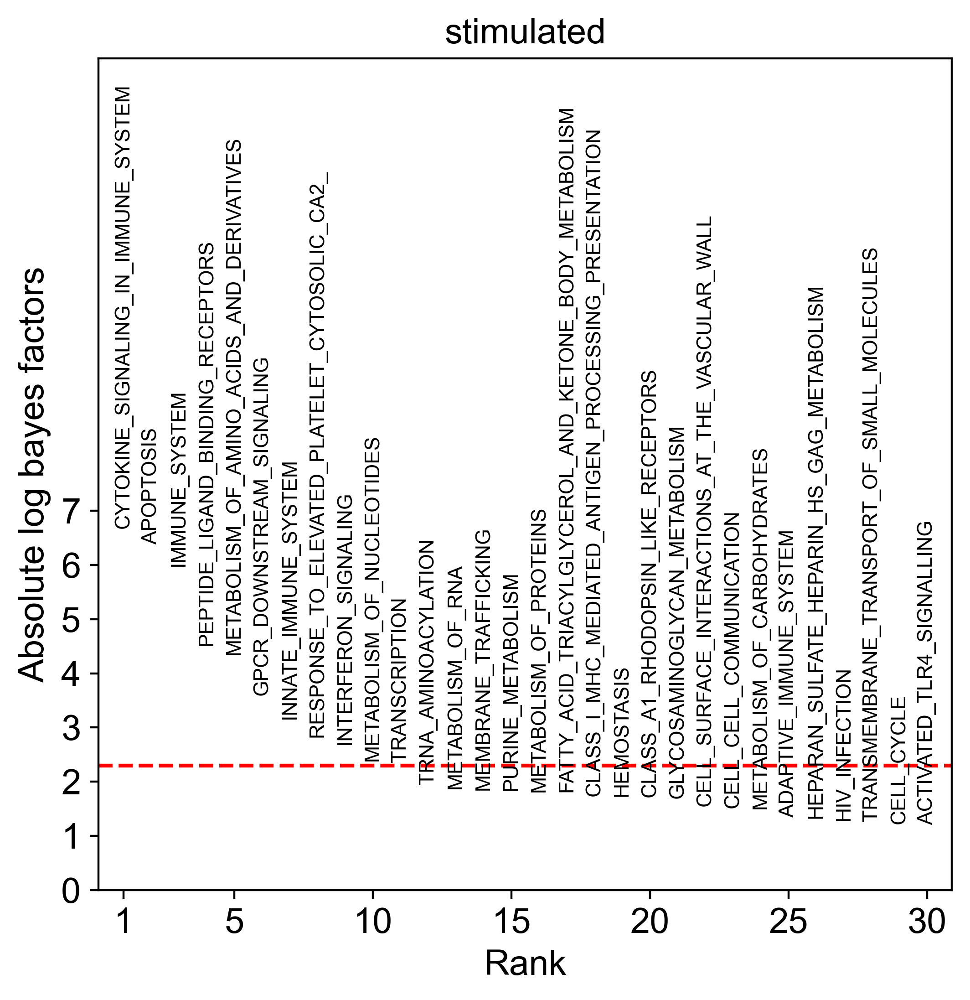

In [32]:
fig = sca.plotting.plot_abs_bfs(scores_mono_cond, np.array(adata.uns["full_terms"]), keys='stimulated', yt_step=1, fontsize=8, scale_y=2.3)

In [69]:
adata

AnnData object with n_obs × n_vars = 13576 × 1981
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'stim', 'seurat_annotations', 'integrated_snn_res.0.5', 'seurat_clusters', 'condition', 'cell_type', 'study', 'cell_type_joint', 'INTERFERON_SIGNALING', 'CYTOKINE_SIGNALING_IN_IMMUNE_SYSTEM', 'MHC_CLASS_II_ANTIGEN_PRESENTATION', 'ANTIGEN_ACTIVATES_B_CELL_RECEPTOR', 'cells_b', 'cells_mono', 'cells_mono_merge', 'TRANSMEMBRANE_TRANSPORT_OF_SMALL_MOLECULES', 'PLATELET_ACTIVATION_SIGNALING_AND_AGGREGATION'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'terms', 'full_terms', 'hvg', 'neighbors', 'umap', 'cell_type_joint_colors', 'condition_colors', 'cells_b_colors', 'cells_mono_colors'
    obsm: 'X_cvae', 'X_umap'
    varm: 'I'
    obsp: 'distances', 'connectivities'

In [70]:
scores_b = intr_cvae.latent_enrich('cells_b', comparison="others", adata=adata[adata.obs.condition=="control"], 
                                    n_perm=8000, exact=True)

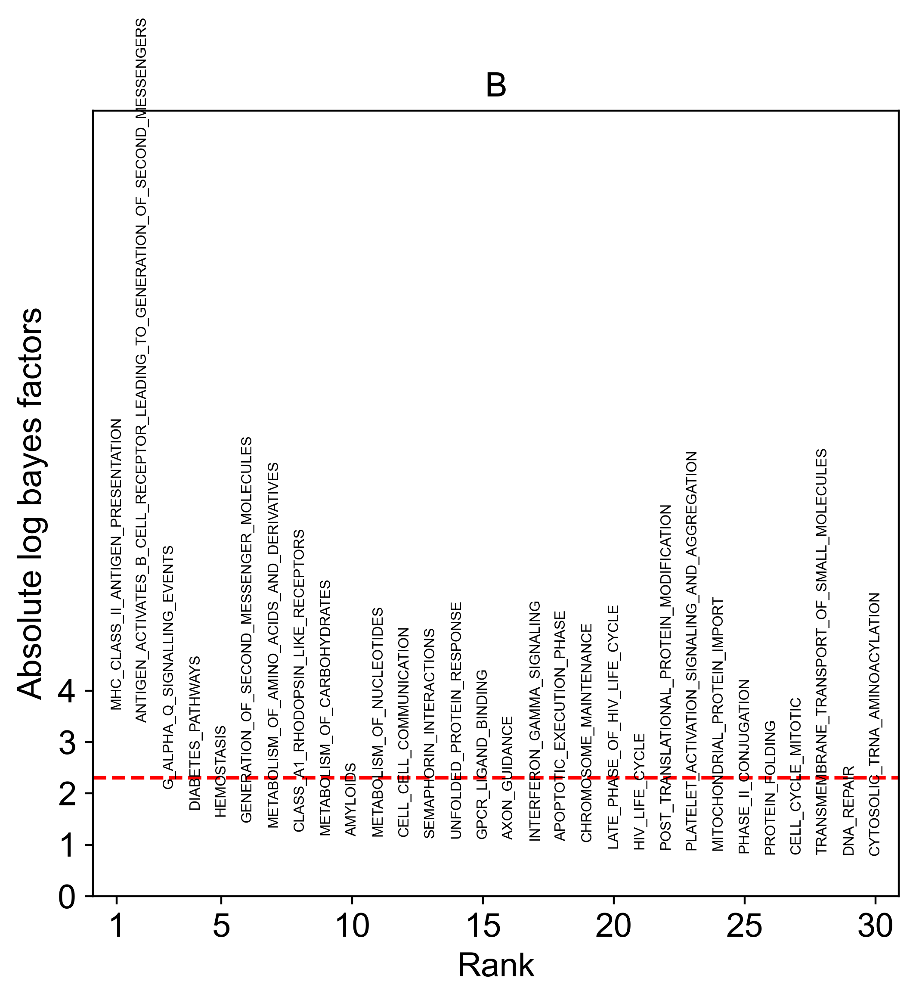

In [71]:
fig = sca.plotting.plot_abs_bfs(scores_b, np.array(adata.uns["full_terms"]), keys='B', yt_step=1, fontsize=6, scale_y=4.2)